In [1]:
import pickle
import random
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing.image import ImageDataGenerator
import os
import matplotlib.pyplot as plt
import random
from PIL import Image
import  cv2
from imblearn.over_sampling import SMOTE
from keras.preprocessing.image import ImageDataGenerator

from sklearn.metrics import confusion_matrix
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input

import tensorflow as tf
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.applications import ResNet50
from sklearn.metrics.pairwise import cosine_similarity

import pandas as pd
from numpy import trapz

from tensorflow.keras.applications.resnet50 import ResNet50
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import Adam
import keras

In [4]:
size=72

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


<h2>Train</h2>

In [19]:
with open('/content/drive/MyDrive/train_data.pickle', 'rb') as f:
    x_train, y_train = pickle.load(f)

In [20]:
resized_images = []
for image in x_train:
    resized_image = cv2.resize(image, (size, size))
    resized_images.append(resized_image)
resized_images=np.array(resized_images)
resized_data = (resized_images, y_train)
with open('/content/drive/MyDrive/resized_train_data.pickle', 'wb') as f:
    pickle.dump((resized_images, y_train), f)

In [21]:
with open('/content/drive/MyDrive/resized_train_data.pickle', 'rb') as f:
    x_train, y_train = pickle.load(f)

In [22]:
print(x_train.shape,y_train.shape)

(14569, 72, 72, 3) (14569,)


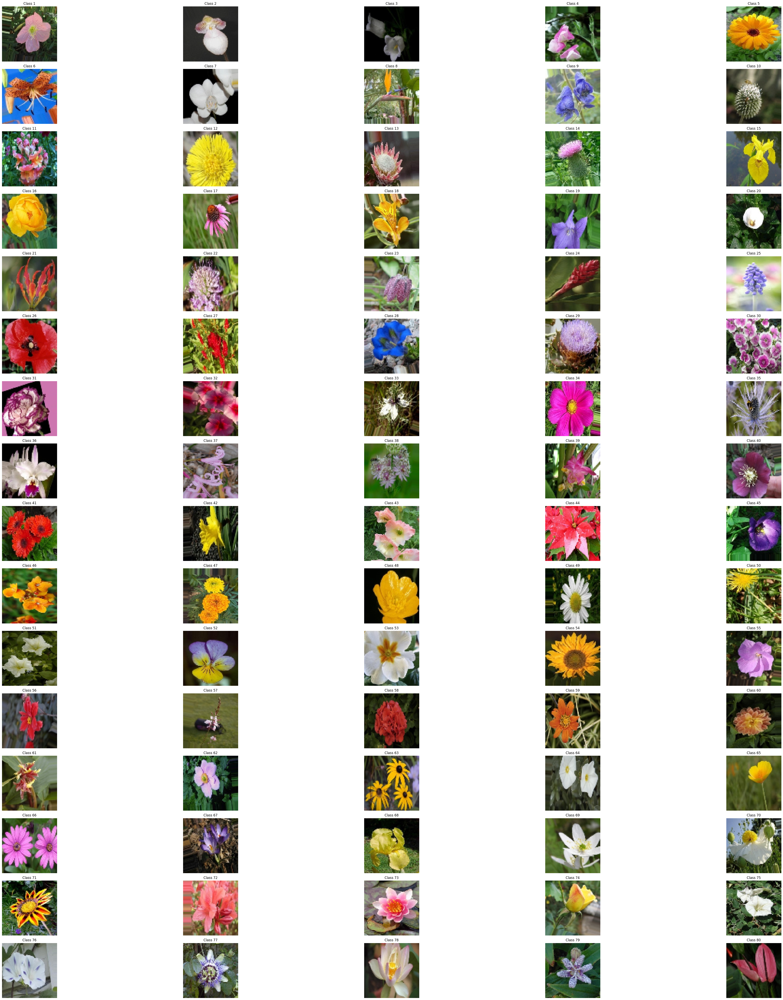

In [23]:
num_classes = 80
samples_per_class = 1
rows = 16
cols = 5

fig, axes = plt.subplots(rows, cols, figsize=(50, 50))

for label in range(num_classes):
    label_indices = np.where(y_train == label)[0]
    random_indices = np.random.choice(label_indices, samples_per_class, replace=False)

    for i, idx in enumerate(random_indices):
        img = x_train[idx]
        ax = axes[label // cols, label % cols]
        ax.imshow(img[:,:,::-1])
        ax.axis('off')
        ax.set_title(f'Class {label+1}')

plt.tight_layout()
plt.show()

<h2>Validation</h2>

In [24]:
with open('/content/drive/MyDrive/valid_data.pickle', 'rb') as f:
    x_valid, y_valid = pickle.load(f)

In [25]:
resized_images = []
for image in x_valid:
    resized_image = cv2.resize(image, (size, size))
    resized_images.append(resized_image)
resized_images=np.array(resized_images)
with open('/content/drive/MyDrive/resized_valid_data.pickle', 'wb') as f:
    pickle.dump((resized_images, y_valid), f)

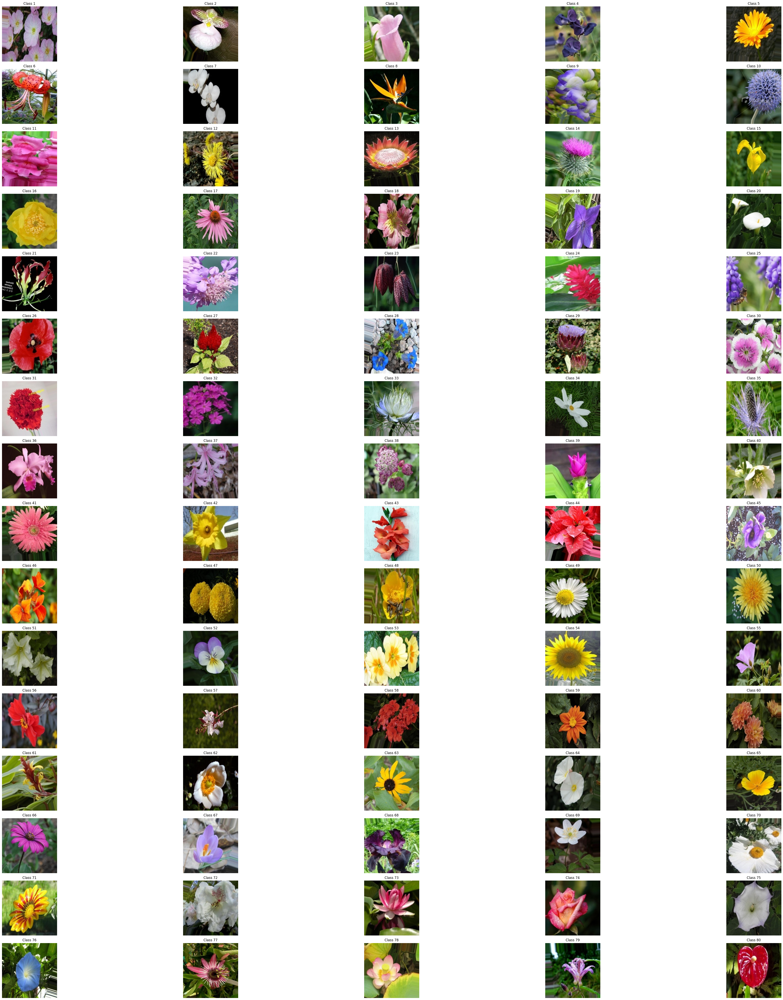

In [26]:
num_classes = 80
samples_per_class = 1
rows = 16
cols = 5

fig, axes = plt.subplots(rows, cols, figsize=(50, 50))

for label in range(num_classes):
    label_indices = np.where(y_valid == label)[0]
    random_indices = np.random.choice(label_indices, samples_per_class, replace=False)

    for i, idx in enumerate(random_indices):
        img = x_valid[idx]
        ax = axes[label // cols, label % cols]
        ax.imshow(img[:,:,::-1])
        ax.axis('off')
        ax.set_title(f'Class {label+1}')

plt.tight_layout()
plt.show()

<h2>Test</h2>

In [28]:
with open('/content/drive/MyDrive/test_data.pickle', 'rb') as f:
    x_test, y_test = pickle.load(f)

In [29]:
print(len(y_test))

11275


In [33]:
x_test1 = np.zeros((len(y_test), 2, size, size, 3), dtype=np.uint8)
for i,image in enumerate(x_test):
    x_test1[i,0] = cv2.resize(image[0], (size, size))
    x_test1[i,1] = cv2.resize(image[1], (size, size))
# with open('/content/drive/MyDrive/resized_valid_data.pickle', 'wb') as f:
#     pickle.dump((resized_images, y_valid), f)

In [34]:
print(x_test1.shape)

(11275, 2, 72, 72, 3)


In [35]:
with open('/content/drive/MyDrive/resized_test_data.pickle', 'wb') as f:
    pickle.dump((x_test1, y_test), f)

In [36]:
with open('/content/drive/MyDrive/resized_test_data.pickle', 'rb') as f:
    x_test, y_test = pickle.load(f)

[11149 10585  9577  8194  8182 10324 10077 10651  8021  8953  3326  4524
  4321  2995  2897  5336  3871  2974   572   815]


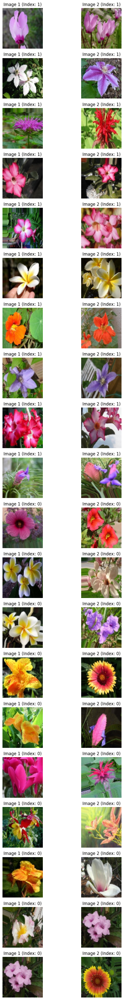

In [39]:
indices_1 =np.random.choice(np.where(y_test == 1)[0],size=10)


indices_0 =np.random.choice( np.where(y_test == 0)[0],size=10)

inc=np.concatenate([indices_1,indices_0])
print(inc)


# نمایش تصاویر متناظر با ایندکس‌های داده شده
def show_images(indices, images):
    fig, axes = plt.subplots(len(indices), 2, figsize=(8, 2*len(indices)))
    for i, index in enumerate(indices):
        axes[i, 0].imshow(images[index][0][:,:,::-1])
        axes[i, 0].axis('off')
        axes[i, 0].set_title(f'Image 1 (Index: {y_test[index]})')

        axes[i, 1].imshow(images[index][1][:,:,::-1])
        axes[i, 1].axis('off')
        axes[i, 1].set_title(f'Image 2 (Index: {y_test[index]})')

    plt.tight_layout()
    plt.show()


show_images(inc, x_test)

<h2>ValidationLFW</h2>

In [40]:
with open('/content/drive/MyDrive/validLFW_data.pickle', 'rb') as f:
    x_validLFW, y_validLFW = pickle.load(f)

In [41]:
x_validLFW1 = np.zeros((len(y_validLFW), 2, size, size, 3), dtype=np.uint8)
for i,image in enumerate(x_validLFW):
    x_validLFW1[i,0] = cv2.resize(image[0], (size, size))
    x_validLFW1[i,1] = cv2.resize(image[1], (size, size))

In [42]:
with open('/content/drive/MyDrive/resized_validLFW_data.pickle', 'wb') as f:
    pickle.dump((x_validLFW1, y_validLFW), f)

In [43]:
with open('/content/drive/MyDrive/resized_validLFW_data.pickle', 'rb') as f:
    x_validLFW, y_validLFW = pickle.load(f)

[ 5162  8643 10542  8161 10779  6521 10223 10522  5554  8868    76   297
  4363  2877  3609   405  3837  3683  5977  2759]


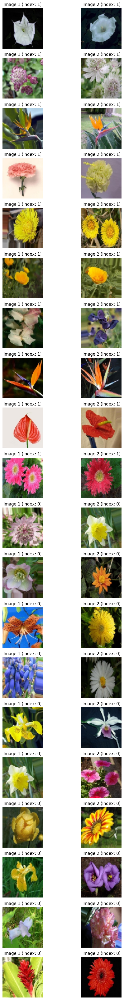

In [44]:

indices_1 =np.random.choice(np.where(y_validLFW == 1)[0],size=10)


indices_0 =np.random.choice( np.where(y_validLFW == 0)[0],size=10)

inc=np.concatenate([indices_1,indices_0])
print(inc)


# نمایش تصاویر متناظر با ایندکس‌های داده شده
def show_images(indices, images):
    fig, axes = plt.subplots(len(indices), 2, figsize=(8, 2*len(indices)))
    for i, index in enumerate(indices):
        axes[i, 0].imshow(images[index][0][:,:,::-1])
        axes[i, 0].axis('off')
        axes[i, 0].set_title(f'Image 1 (Index: {y_validLFW[index]})')

        axes[i, 1].imshow(images[index][1][:,:,::-1])
        axes[i, 1].axis('off')
        axes[i, 1].set_title(f'Image 2 (Index: {y_validLFW[index]})')

    plt.tight_layout()
    plt.show()


show_images(inc, x_validLFW)

In [45]:
print(x_test.shape)

(11275, 2, 72, 72, 3)
